# Topic Modeling

In [1]:
# Standard Data Processing
import numpy as np
import pandas as pd

# NLP
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import NMF
from nltk.tokenize import TweetTokenizer
from nltk import SnowballStemmer
from sklearn.manifold import TSNE
import nltk

# Helper Functions
from Py_Files.pipeline import NLPPipe, tweet_clean1
from Py_Files.helper_functions import txt_to_df, display_topics

# Visualization Packages
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib
%matplotlib inline
import seaborn as sns
import matplotlib.ticker as mtick

# Other
import re
import pickle
%load_ext autoreload
%autoreload 2

In [2]:
all_tweets = pd.read_pickle("Pickles/tweets_year2.pkl")
corpus_list = all_tweets[all_tweets['year']!=2015]['long_text'].tolist()
# Pull out the tweets, but without 2015
# Discovered 2015 was messing up our model in text_processing.ipynb

In [3]:
stopwords = nltk.corpus.stopwords.words('english')
add_these = ['vegan','plantbas','http','rt','ur','youtub','pinterest','linkedln','twitter','facebook','vegetarian','foodo','eat','get','new','go','day','govega','free','one','make','try','like','know','time','us','today','great','want','im','need','see','best','whi','tri','good','look','come','thing','got','think','dont','made','way','would','deshawnmari','food','foodi','rawpassionuk','check','take','say','realli','find','mani']
stopwords.extend(add_these)
# Discovered these were important stopwords to get discernable topics

In [4]:
nlp2 = NLPPipe(vectorizer=TfidfVectorizer(stop_words=stopwords, max_df=0.80, min_df=10), 
              tokenizer=TweetTokenizer().tokenize, 
              stemmer=SnowballStemmer("english"),
              cleaning_function=tweet_clean1)
# Establish the pipeline

In [5]:
nlp2.fit(corpus_list)
dtm_tfidf = nlp2.transform(corpus_list)
# Fit our corpus

A lot of exploration was necessary to hone in on 23 topics, but it took up a lot of space within the notebook so I removed the noise and left the ideal scenario.

In [84]:
nmf_model = NMF(23,random_state=1)
doc_topic = nmf_model.fit_transform(dtm_tfidf)
display_topics(nmf_model, nlp2.vectorizer.get_feature_names(), 25)
# 0 = Blogs/Articles, 1 = Fitness/Weightloss, 2 = Animal Rights, 3 = Salad, 4 = Dessert, 5 = Positivity/Generic, 6 = Beauty Products, 7 = Resitrcted Diets, 8 = Social Media, 9 = Vegan Hashtags, 10 = Skincare, 11 = Soap, 12 = Breakfast, 13 = Meals, 14 = Competition, 15 = 'Fake' Foods, 16 = Ice Cream, 17 = Nutrition, 18 = Baking, 19 = Lifestyle, 20 = Cheese, 21 = Dating, 22 = Vegetables/Ingredients


Topic  0
recip, easi, veganrecip, meatlessmonday, cook, blog, pleas, raw, nocruelti, cheesecak, pumpkin, inspir, cookbook, video, idea, link, recipeoftheday, travel, dessert, simpl, healthyfood, whatveganseat, summer, bake, tasti

Topic  1
health, diet, nutrit, fit, well, plant, protein, benefit, base, lifestyl, weightloss, workout, help, healthyeat, motiv, exercis, healthyliv, life, paleo, healthylifestyl, vitamin, superfood, live, fitfood, healthyfood

Topic  2
anim, human, live, compass, animalright, peopl, right, kill, stop, life, cruelti, save, pleas, planet, help, onli, farm, becaus, product, world, suffer, digoutyoursoul, kind, abus, environ

Topic  3
lunch, salad, summer, avocado, sandwich, dress, perfect, quinoa, fresh, kale, meatlessmonday, favorit, menu, wrap, cucumb, yummi, chickpea, bowl, tofu, week, tomato, hummus, veganfood, box, fruit

Topic  4
chocol, cooki, chip, butter, peanut, dessert, dark, bar, banana, cheesecak, browni, pud, raspberri, almond, muffin, bake, fudg

In [7]:
H = pd.DataFrame(doc_topic.round(5),
             index = corpus_list,
             columns = ["0","1",'2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22'])
# Create the Topic Document matrix

In [8]:
H_topic = H.idxmax(axis=1)
# Assign topics to each document based on the largest value in the Topic Document matrix

In [9]:
plotting_x = TSNE(random_state=0,perplexity=50,metric='cosine').fit_transform(H)
# Use TSNE to help plot the data

In [10]:
no_2015 = all_tweets[all_tweets['year']!=2015]
# Remove 2015 tweets from the master DataFrame

In [11]:
no_2015['x'] = plotting_x[:,1]
no_2015['y'] = plotting_x[:,0]
# Put the coordinates into the DataFrame

In [12]:
no_2015['topic_num'] = H.idxmax(axis=1).tolist()
# Put the topic numbers into the DataFrame

In [32]:
tsne = pd.read_pickle("Pickles/TSNE.pkl")

After exploring the 23 topics, I realized they could be further categorized in more broad topics to help explain the tweets better.

In [33]:
media = ['0','8','9','14']
bath = ['6','10','11']
food = ['3','4','12','13','15','16','18','20','22']
lifestyle = ['1','5','7','17','19','21']
animals = ['2']

def to_topic(row):
    num = row['topic_num']
    if num in media:
        row['bigger_topic'] = 'media'
    if num in bath:
        row['bigger_topic'] = 'bath'
    if num in food:
        row['bigger_topic'] = 'food'
    if num in lifestyle:
        row['bigger_topic'] = 'lifestyle'
    if num in animals:
        row['bigger_topic'] = 'animals'
    return row
# Bucket the topics into bigger categories and define a function to help label the tweets in the DataFrame

In [34]:
tsne = tsne.apply(to_topic,axis=1)
# Apply that topic

In [35]:
topics = ['Blogs/Articles','Fitness/Weightloss','Animal Activism','Salads','Desserts','Positivity','Beauty Products','Restricted Diets','Social Media','Vegan Hashtags','Skin Care','Soap','Breakfast','Meals','Contests',"'Fake' Foods",'Ice Cream','Nutrition','Baking','Lifestyle','Cheese','Dating','Vegetables/Ingredients']
# Define a list to map our topic numbers to topic names

In [36]:
topic_order = [
    'Blogs/Articles','Social Media','Vegan Hashtags','Contests',
    'Beauty Products','Skin Care','Soap',
    'Salads','Desserts','Breakfast','Meals',"'Fake' Foods",'Ice Cream','Cheese','Vegetables/Ingredients','Baking',
    'Fitness/Weightloss','Positivity','Restricted Diets','Nutrition','Lifestyle','Dating',
    'Animal Activism'
]
# Define the order of the list for the plotting legends

In [37]:
def topic(row):
    num = int(row['topic_num'])
    row['topic_name'] = topics[num]
    return row
# Using the topics list to map our topic numbers to topic names

In [38]:
tsne = tsne.apply(topic,axis=1)

### Time to make some plots of our topics

In [57]:
plt.rcParams["font.family"] = "Arial"

In [59]:
year_dfs = []
for i in [2016,2017,2018,2019,2020]:
    year_dfs.append(tsne[tsne['year']==i])
# Make DataFrames for each year to help with plotting

In [61]:
tot_tw = []
for year in [2016,2017,2018,2019,2020]:
    tot_tw.append(len(tsne[tsne['year']==year]))
tallies = pd.DataFrame(data=tot_tw,index=[2016,2017,2018,2019,2020],columns=['Total Tweets'])

In [62]:
tallies['Food'] = tallies.apply(lambda row: len(tsne[(tsne['bigger_topic']=='food') & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)
tallies['Lifestyle'] = tallies.apply(lambda row: len(tsne[(tsne['bigger_topic']=='lifestyle') & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)
tallies['Animals'] = tallies.apply(lambda row: len(tsne[(tsne['bigger_topic']=='animals') & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)
tallies['Media'] = tallies.apply(lambda row: len(tsne[(tsne['bigger_topic']=='media') & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)
tallies['Bath'] = tallies.apply(lambda row: len(tsne[(tsne['bigger_topic']=='bath') & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)
for topic in tsne['topic_name'].unique().tolist():
    tallies[f'{topic}'] = tallies.apply(lambda row: len(tsne[(tsne['topic_name']==topic) & (tsne['year']==row.name)])/row['Total Tweets'],axis=1)

In [63]:
tallies

,Total Tweets,Food,Lifestyle,Animals,Media,Bath,Vegetables/Ingredients,'Fake' Foods,Animal Activism,Baking,...,Cheese,Skin Care,Nutrition,Desserts,Fitness/Weightloss,Dating,Restricted Diets,Social Media,Soap,Breakfast
2016,9191,0.446197,0.036449,0.064302,0.131651,0.104885,0.103688,0.075073,0.064302,0.032858,...,0.068437,0.038951,0.042433,0.035796,0.034164,0.040474,0.060712,0.033402,0.010336,0.036231
2017,9471,0.436702,0.031992,0.069370,0.142012,0.107380,0.106430,0.078872,0.069370,0.027135,...,0.066519,0.040228,0.042023,0.031253,0.034315,0.049308,0.052159,0.030092,0.009080,0.031359
2018,9858,0.417427,0.028505,0.062284,0.130655,0.136336,0.105092,0.069588,0.062284,0.023636,...,0.060357,0.044532,0.046561,0.030534,0.037634,0.037939,0.052242,0.024143,0.012781,0.031649
2019,9835,0.424504,0.030300,0.073411,0.115404,0.137570,0.101983,0.094255,0.073411,0.023691,...,0.055618,0.039756,0.042908,0.026945,0.043518,0.041281,0.043721,0.025623,0.027046,0.028673
2020,10377,0.449841,0.026019,0.148694,0.117760,0.100896,0.089043,0.191770,0.148694,0.018310,...,0.062446,0.021972,0.023128,0.017250,0.054158,0.023803,0.017442,0.021586,0.017250,0.017057


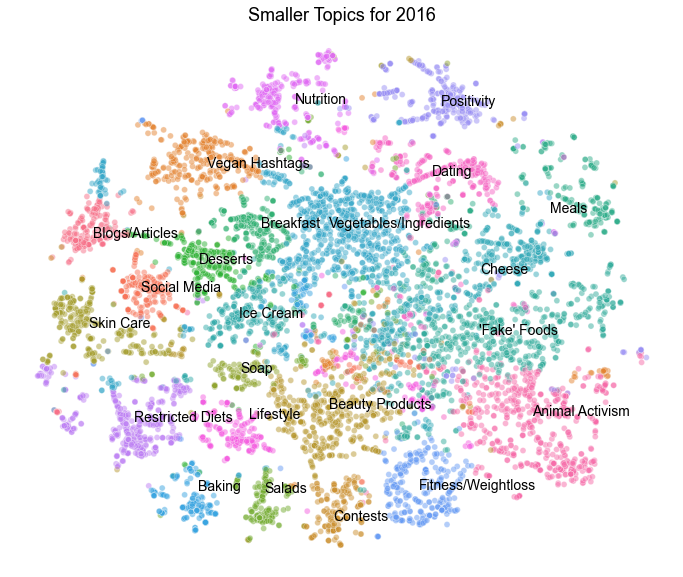

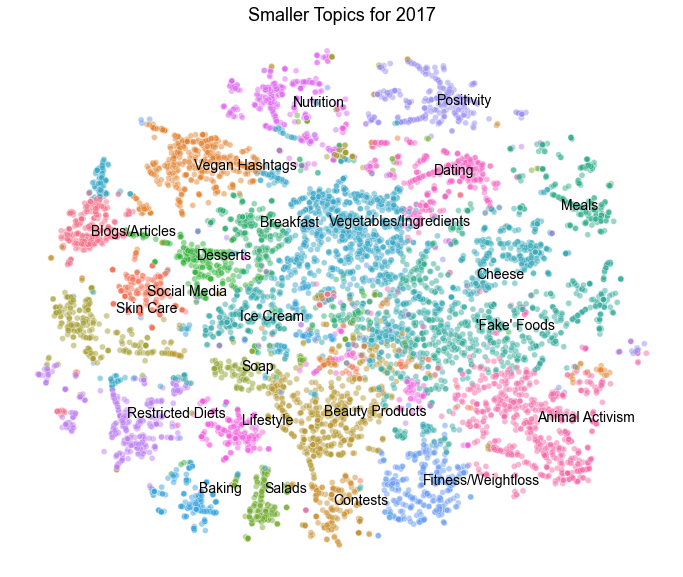

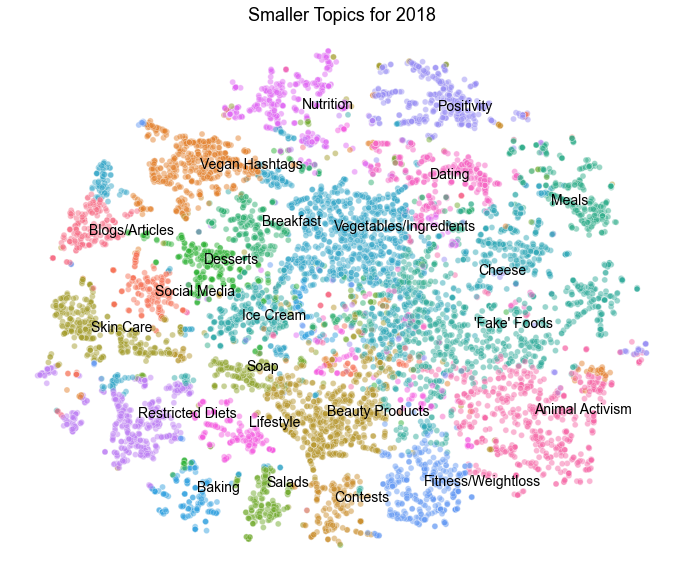

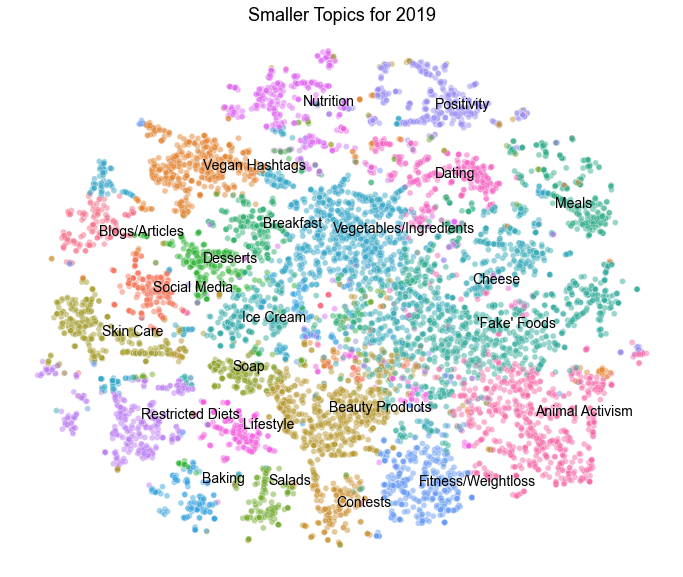

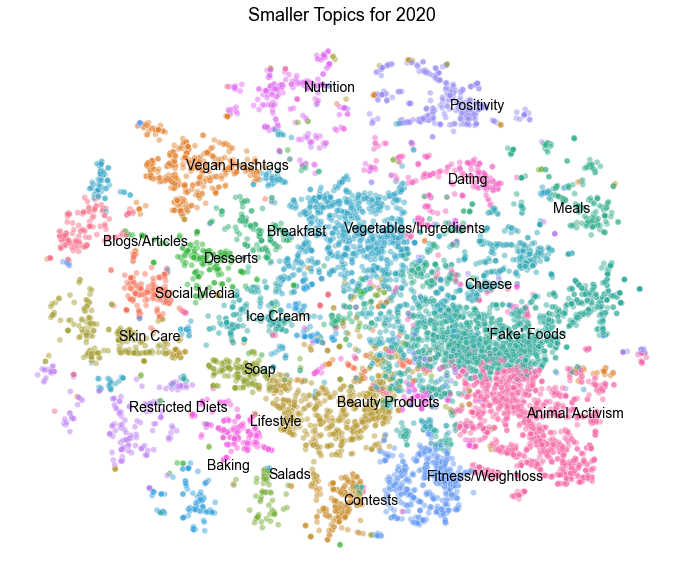

In [60]:
for df in year_dfs:
    fig, ax = plt.subplots()
    fig.set_size_inches(12,10)
    sns.scatterplot(df['x'],df['y'],hue=df['topic_name'],alpha=0.5,hue_order=topic_order)
    txts = []
    for i in topics:
        xtext, ytext = np.median(df[df['topic_name']==i].loc[:,'x':'y'],axis=0)
        txt = ax.text(xtext, ytext, i, fontsize=14)
        txts.append(txt)
    ax.get_legend().remove()
    plt.title('Smaller Topics for {}'.format(int(df['year'].median())))
    plt.axis('off');
    # plt.savefig('sm_topics{}.png'.format(int(df['year'].median())),bbox_inches='tight');

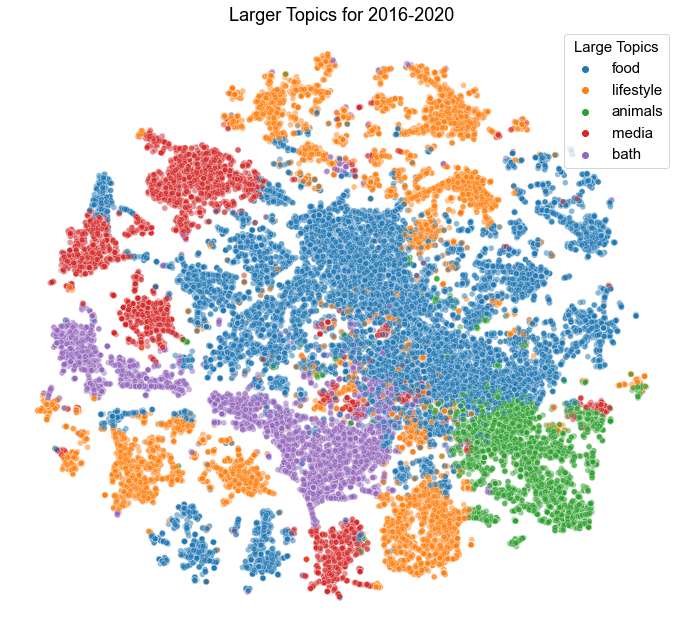

In [52]:
fig, ax = plt.subplots()
fig.set_size_inches(12,11)
sns.scatterplot(tsne['x'],tsne['y'],hue=tsne['bigger_topic'],alpha=0.5)
ax.legend(title='Large Topics',loc='upper right')
plt.title('Larger Topics for 2016-2020',fontsize=18)
plt.axis('off');
# plt.savefig('Images/lrg_all_yrs.png',bbox_inches='tight');

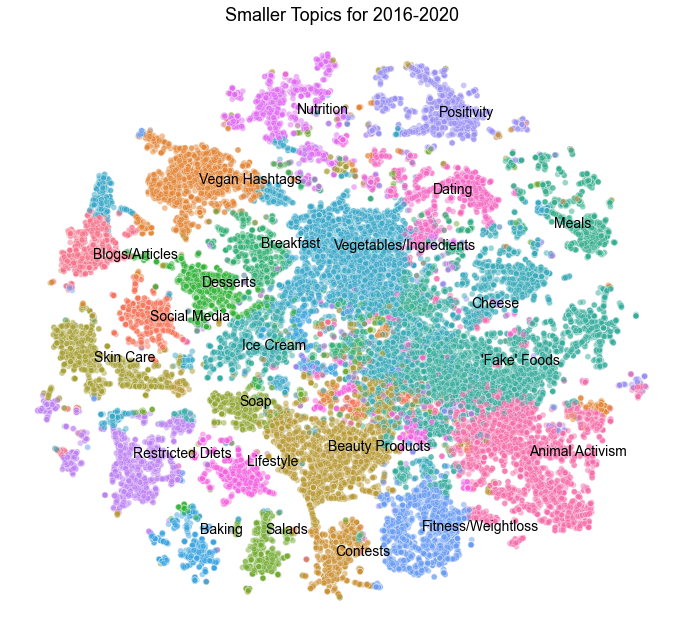

In [58]:
fig, ax = plt.subplots()
fig.set_size_inches(12,11)
sns.scatterplot(tsne['x'],tsne['y'],hue=tsne['topic_name'],alpha=0.5,hue_order=topic_order)
txts = []
for i in topics:
    xtext, ytext = np.median(tsne[tsne['topic_name']==i].loc[:,'x':'y'],axis=0)
    txt = ax.text(xtext, ytext, i, fontsize=14)
    txts.append(txt)
ax.get_legend().remove()
plt.title('Smaller Topics for 2016-2020',fontsize=18)
plt.axis('off');
# plt.savefig('Images/sm_all_yrs.png',bbox_inches='tight');

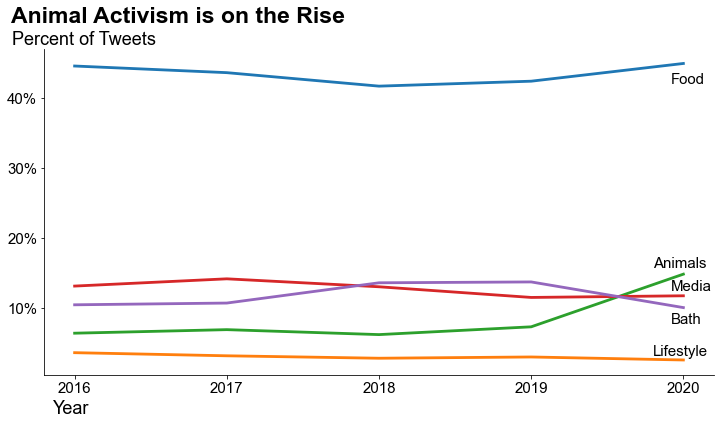

In [65]:
fig, ax = plt.subplots()
plt.rcParams["font.family"] = "Arial"
fig.set_size_inches(12,6)
ax = sns.lineplot(data=tallies.iloc[:,1:6],dashes=False,linewidth=2.8)
plt.rc('font', size=15)
plt.xlabel('Year',size=18,x=0.040)
plt.ylabel('Percent of Tweets',size=18,y=1).set_rotation(0)
plt.title('Animal Activism is on the Rise',y=1.06,x=0.2,size=23,fontweight="bold")
ax.yaxis.set_label_coords(0.06,1)
plt.xticks([2016,2017,2018,2019,2020])
plt.text(x = 2019.92, y = 0.42, s = 'Food')
plt.text(x = 2019.80, y = 0.032, s = 'Lifestyle')
plt.text(x = 2019.80, y = 0.158, s = 'Animals')
plt.text(x = 2019.92, y = 0.125, s = 'Media')
plt.text(x = 2019.92, y = 0.078, s = 'Bath')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1, decimals=0))
ax.get_legend().remove();
# plt.savefig('big_topics.png',bbox_inches='tight');

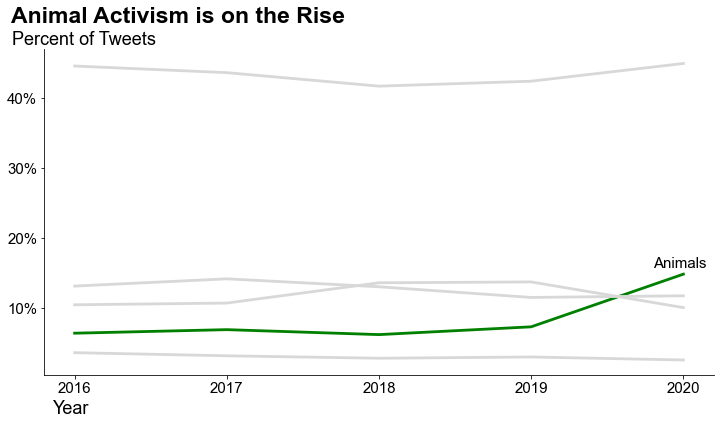

In [66]:
fig, ax = plt.subplots()
fig.set_size_inches(12,6)
ax = sns.lineplot(data=tallies.iloc[:,1:6],dashes=False,palette=['#D8D8D8','#D8D8D8','green','#D8D8D8','#D8D8D8'],linewidth=2.8)
plt.rc('font', size=15)
plt.xlabel('Year',size=18,x=0.040)
plt.ylabel('Percent of Tweets',size=18,y=1).set_rotation(0)
plt.title('Animal Activism is on the Rise',y=1.06,x=0.2,size=23,fontweight="bold")
ax.yaxis.set_label_coords(0.06,1)
plt.xticks([2016,2017,2018,2019,2020])
plt.text(x = 2019.80, y = 0.158, s = 'Animals')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1, decimals=0))
ax.get_legend().remove();
# plt.savefig('big_topics_animals.png',bbox_inches='tight');

In [67]:
greys = dict({
    'Blogs/Articles':'#D8D8D8',
    'Fitness/Weightloss':'#D8D8D8',
    'Animal Activism':'#14FF00',
    'Salads':'#D8D8D8',
    'Desserts':'#D8D8D8',
    'Positivity':'#D8D8D8',
    'Beauty Products':'#D8D8D8',
    'Restricted Diets':'#D8D8D8',
    'Social Media':'#D8D8D8',
    'Vegan Hashtags':'#D8D8D8',
    'Skin Care':'#D8D8D8',
    'Soap':'#D8D8D8',
    'Breakfast':'#D8D8D8',
    'Meals':'#D8D8D8',
    'Contests':'#D8D8D8',
    "'Fake' Foods":'#5E6DE0',
    'Ice Cream':'#D8D8D8',
    'Nutrition':'#D8D8D8',
    'Baking':'#D8D8D8',
    'Lifestyle':'#D8D8D8',
    'Cheese':'#D8D8D8',
    'Dating':'#D8D8D8',
    'Vegetables/Ingredients':'#D8D8D8'
})

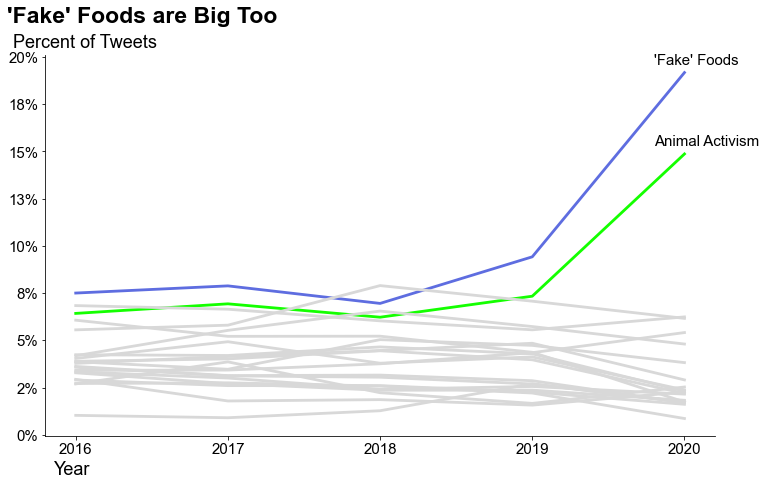

In [68]:
fig, ax = plt.subplots()
plt.rcParams["font.family"] = "Arial"
fig.set_size_inches(12,7)
ax = sns.lineplot(data=tallies.iloc[:,7:],dashes=False,linewidth=2.8,palette=greys)
plt.rc('font', size=15)
plt.xlabel('Year',size=18,x=0.040)
plt.ylabel('Percent of Tweets',size=18).set_rotation(0)
plt.title("'Fake' Foods are Big Too",y=1.07,x=0.145,size=23,fontweight="bold")
ax.yaxis.set_label_coords(0.06,1.01)
plt.xticks([2016,2017,2018,2019,2020])
plt.text(x = 2019.80, y = 0.196, s = "'Fake' Foods")
plt.text(x = 2019.80, y = 0.153, s = 'Animal Activism')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1, decimals=0))
ax.get_legend().remove();
# plt.savefig('small_scale.png',bbox_inches='tight')

In [83]:
print("Percentage of Tweets about Food: {:.4}%".format((tallies['Food'].mean())*100))

Percentage of Tweets about Food: 43.49%
